## Business Objective 


The dataset contains 9358 instances of hourly averaged responses 

**Objective :**  

Predict the Relative Humidity at a given point of time based on all other attributes affecting the change in RH.



# Importing Packages

In [78]:
import pandas as pd
import numpy as np
import datetime as dt
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
import plotly.graph_objects as go
from pandas_profiling import ProfileReport
import warnings
warnings.filterwarnings('ignore')
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
import xgboost as xgb
from xgboost import plot_importance, plot_tree
from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn.model_selection import RandomizedSearchCV

## Importing csv file

In [79]:
data = pd.read_csv("AirQualityUCI.csv")

**Obeservation**: There is -200 value in most of the columns as min value and the last two columns 
are empty


In [80]:
data.describe(include = 'all')

,Date,Time,CO(GT),PT08.S1(CO),NMHC(GT),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH,Unnamed: 15,Unnamed: 16
count,9357,9357,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,0.0,0.0
unique,391,24,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
top,1/3/2005,14:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
freq,24,390,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,NaN,NaN,-34.207524,1048.990061,-159.090093,1.865683,894.595276,168.616971,794.990168,58.148873,1391.479641,975.072032,9.778305,39.485380,-6.837604,NaN,NaN
std,NaN,NaN,77.657170,329.832710,139.789093,41.380206,342.333252,257.433866,321.993552,126.940455,467.210125,456.938184,43.203623,51.216145,38.976670,NaN,NaN
min,NaN,NaN,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,NaN,NaN
25%,NaN,NaN,0.600000,921.000000,-200.000000,4.000000,711.000000,50.000000,637.000000,53.000000,1185.000000,700.000000,10.900000,34.100000,0.692300,NaN,NaN
50%,NaN,NaN,1.500000,1053.000000,-200.000000,7.900000,895.000000,141.000000,794.000000,96.000000,1446.000000,942.000000,17.200000,48.600000,0.976800,NaN,NaN
75%,NaN,NaN,2.600000,1221.000000,-200.000000,13.600000,1105.000000,284.000000,960.000000,133.000000,1662.000000,1255.000000,24.100000,61.900000,1.296200,NaN,NaN


We have 17 columns with rows 9471

In [81]:
data.shape

(9471, 17)

In [82]:
data.head()

,Date,Time,CO(GT),PT08.S1(CO),NMHC(GT),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH,Unnamed: 15,Unnamed: 16
0,3/10/2004,18:00:00,2.6,1360.0,150.0,11.9,1046.0,166.0,1056.0,113.0,1692.0,1268.0,13.6,48.9,0.7578,NaN,NaN
1,3/10/2004,19:00:00,2.0,1292.0,112.0,9.4,955.0,103.0,1174.0,92.0,1559.0,972.0,13.3,47.7,0.7255,NaN,NaN
2,3/10/2004,20:00:00,2.2,1402.0,88.0,9.0,939.0,131.0,1140.0,114.0,1555.0,1074.0,11.9,54.0,0.7502,NaN,NaN
3,3/10/2004,21:00:00,2.2,1376.0,80.0,9.2,948.0,172.0,1092.0,122.0,1584.0,1203.0,11.0,60.0,0.7867,NaN,NaN
4,3/10/2004,22:00:00,1.6,1272.0,51.0,6.5,836.0,131.0,1205.0,116.0,1490.0,1110.0,11.2,59.6,0.7888,NaN,NaN


In [83]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9471 entries, 0 to 9470
Data columns (total 17 columns):
Date             9357 non-null object
Time             9357 non-null object
CO(GT)           9357 non-null float64
PT08.S1(CO)      9357 non-null float64
NMHC(GT)         9357 non-null float64
C6H6(GT)         9357 non-null float64
PT08.S2(NMHC)    9357 non-null float64
NOx(GT)          9357 non-null float64
PT08.S3(NOx)     9357 non-null float64
NO2(GT)          9357 non-null float64
PT08.S4(NO2)     9357 non-null float64
PT08.S5(O3)      9357 non-null float64
T                9357 non-null float64
RH               9357 non-null float64
AH               9357 non-null float64
Unnamed: 15      0 non-null float64
Unnamed: 16      0 non-null float64
dtypes: float64(15), object(2)
memory usage: 1.2+ MB


**Observation**: We have 9357 valid values and the rest 114 values are null values

# Data Cleaning

 Dropping the columns

In [84]:
data.drop(['Unnamed: 15','Unnamed: 16'],axis = 1,inplace  = True)

In [85]:
data.isnull().sum()

Date             114
Time             114
CO(GT)           114
PT08.S1(CO)      114
NMHC(GT)         114
C6H6(GT)         114
PT08.S2(NMHC)    114
NOx(GT)          114
PT08.S3(NOx)     114
NO2(GT)          114
PT08.S4(NO2)     114
PT08.S5(O3)      114
T                114
RH               114
AH               114
dtype: int64

keeping only the non-null values

In [86]:
data = data.iloc[:9357]

In [87]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9357 entries, 0 to 9356
Data columns (total 15 columns):
Date             9357 non-null object
Time             9357 non-null object
CO(GT)           9357 non-null float64
PT08.S1(CO)      9357 non-null float64
NMHC(GT)         9357 non-null float64
C6H6(GT)         9357 non-null float64
PT08.S2(NMHC)    9357 non-null float64
NOx(GT)          9357 non-null float64
PT08.S3(NOx)     9357 non-null float64
NO2(GT)          9357 non-null float64
PT08.S4(NO2)     9357 non-null float64
PT08.S5(O3)      9357 non-null float64
T                9357 non-null float64
RH               9357 non-null float64
AH               9357 non-null float64
dtypes: float64(13), object(2)
memory usage: 1.1+ MB


Now we don't have any null values

In [88]:
data.isnull().sum()

Date             0
Time             0
CO(GT)           0
PT08.S1(CO)      0
NMHC(GT)         0
C6H6(GT)         0
PT08.S2(NMHC)    0
NOx(GT)          0
PT08.S3(NOx)     0
NO2(GT)          0
PT08.S4(NO2)     0
PT08.S5(O3)      0
T                0
RH               0
AH               0
dtype: int64

In [89]:
data['Date'] = pd.to_datetime(data['Date'])
data['Time'] = pd.to_datetime(data['Time'])

Converting 'Date' and 'time' to Timestamp

In [90]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9357 entries, 0 to 9356
Data columns (total 15 columns):
Date             9357 non-null datetime64[ns]
Time             9357 non-null datetime64[ns]
CO(GT)           9357 non-null float64
PT08.S1(CO)      9357 non-null float64
NMHC(GT)         9357 non-null float64
C6H6(GT)         9357 non-null float64
PT08.S2(NMHC)    9357 non-null float64
NOx(GT)          9357 non-null float64
PT08.S3(NOx)     9357 non-null float64
NO2(GT)          9357 non-null float64
PT08.S4(NO2)     9357 non-null float64
PT08.S5(O3)      9357 non-null float64
T                9357 non-null float64
RH               9357 non-null float64
AH               9357 non-null float64
dtypes: datetime64[ns](2), float64(13)
memory usage: 1.1 MB


Now We are replacing -200 value in all the columns with null value

In [91]:
data=data.replace(-200,np.NaN)

In [92]:
data.isnull().sum()

Date                0
Time                0
CO(GT)           1683
PT08.S1(CO)       366
NMHC(GT)         8443
C6H6(GT)          366
PT08.S2(NMHC)     366
NOx(GT)          1639
PT08.S3(NOx)      366
NO2(GT)          1642
PT08.S4(NO2)      366
PT08.S5(O3)       366
T                 366
RH                366
AH                366
dtype: int64

Dropping the null values in output variable as we can't fill with mean , median and mode


In [93]:
data.dropna(axis=0,subset=['RH'],inplace = True)

In [94]:
data.isnull().sum()

Date                0
Time                0
CO(GT)           1647
PT08.S1(CO)         0
NMHC(GT)         8104
C6H6(GT)            0
PT08.S2(NMHC)       0
NOx(GT)          1595
PT08.S3(NOx)        0
NO2(GT)          1598
PT08.S4(NO2)        0
PT08.S5(O3)         0
T                   0
RH                  0
AH                  0
dtype: int64

Too many null values in NMHC(GT) so we just removed this columns and fill with mean value for rest of the columns

In [95]:
data=data.drop(['NMHC(GT)'],axis = 1)

In [96]:
data['CO(GT)'] =data['CO(GT)'].fillna(data['CO(GT)'].mean())
data['NOx(GT)'] =data['NOx(GT)'].fillna(data['NOx(GT)'].mean())
data['NO2(GT)'] =data['NO2(GT)'].fillna(data['NO2(GT)'].mean())

Now we don't have any null values 

In [97]:
data.isnull().sum()

Date             0
Time             0
CO(GT)           0
PT08.S1(CO)      0
C6H6(GT)         0
PT08.S2(NMHC)    0
NOx(GT)          0
PT08.S3(NOx)     0
NO2(GT)          0
PT08.S4(NO2)     0
PT08.S5(O3)      0
T                0
RH               0
AH               0
dtype: int64

Reseting the index

In [98]:
data.reset_index(drop=True,inplace=True)

In [99]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8991 entries, 0 to 8990
Data columns (total 14 columns):
Date             8991 non-null datetime64[ns]
Time             8991 non-null datetime64[ns]
CO(GT)           8991 non-null float64
PT08.S1(CO)      8991 non-null float64
C6H6(GT)         8991 non-null float64
PT08.S2(NMHC)    8991 non-null float64
NOx(GT)          8991 non-null float64
PT08.S3(NOx)     8991 non-null float64
NO2(GT)          8991 non-null float64
PT08.S4(NO2)     8991 non-null float64
PT08.S5(O3)      8991 non-null float64
T                8991 non-null float64
RH               8991 non-null float64
AH               8991 non-null float64
dtypes: datetime64[ns](2), float64(12)
memory usage: 983.5 KB


Creating Hour and Month columns from Time and Date columns.Secondly dropping the Date and time columns in order to avoid correlation

In [100]:
data['Hour'] = data['Time'].dt.hour
data['Month'] = data['Date'].dt.month

data.drop(['Date','Time'],axis = 1,inplace = True)

## Visualization

In [ ]:
def configure_plotly_browser_state():
    import IPython
    display(IPython.core.display.HTML('''
        <script src="/static/components/requirejs/require.js"></script>
        <script>
          requirejs.config({
            paths: {
              base: '/static/base',
              plotly: 'https://cdn.plot.ly/plotly-latest.min.js?noext',
            },
          });
        </script>
        '''))
  



import plotly_express as px

**Observation**: The Temperature and Relative humidity are inversely proportion to each other.For 1,2,3,10,11,12 months  the Relative humidity is high

In [105]:
configure_plotly_browser_state()
px.scatter(data, x="RH", y="T" ,color="Month",
           hover_data=["Hour"], log_x=True, size_max=60)

Perform Pandas profiling to understand quick overview of columns

In [106]:
ProfileReport(data)

From Profiling and Correlation it can be concluded that some of the input variables are highly corrrelated .so we will ty to remove those columns

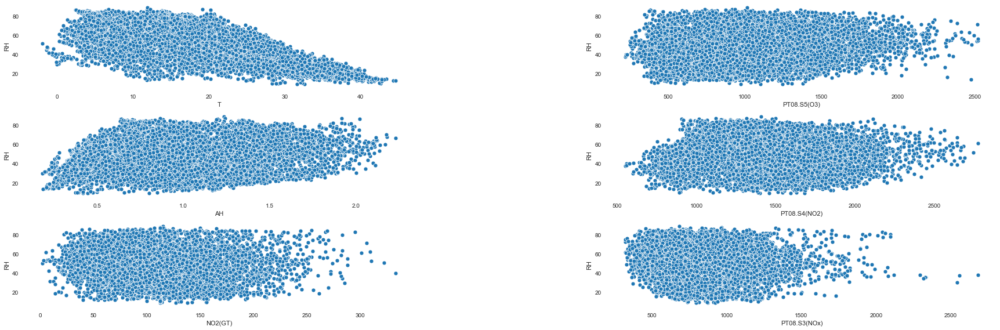

In [24]:
plt.figure(figsize=(30,20))
plt.subplots_adjust(hspace= 0.3, wspace= 0.5)
plt.subplot(6,2,1)
#plt.title ('Temp')
sns.scatterplot(x=data['T'],y=data['RH'],data=data)
plt.subplot(6,2,2)
#plt.title ('PT08.S5(O3)')
sns.scatterplot(x=data['PT08.S5(O3)'],y=data['RH'],data=data)
plt.subplot(6,2,3)
#plt.title ('AH')
sns.scatterplot(x='AH',y='RH',data=data)
plt.subplot(6,2,4)
#plt.title ('PT08.S4(NO2)')
sns.scatterplot(x='PT08.S4(NO2)',y='RH',data=data)
plt.subplot(6,2,5)
#plt.title ('NO2(GT)')
sns.scatterplot(x='NO2(GT)',y='RH',data=data)
plt.subplot(6,2,6)
#plt.title ('PT08.S3(NOx)')
sns.scatterplot(x='PT08.S3(NOx)',y='RH',data=data)
plt.show()

**Observation**: Temp,AH,PT08.S4(NO2) and PT08.S5(O3) have some relationship with RH

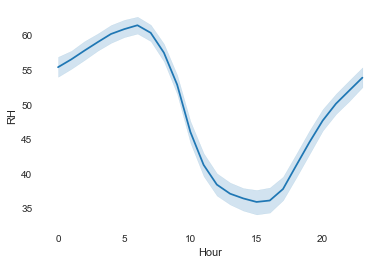

In [25]:
sns.lineplot(x='Hour', y='RH', data=data)

**Observation** : So in the morning the relative humidity is quite high while it dips down during the the time 11am - 16:00pm and again it increases from 16:00pm . So it follows the cosine wave

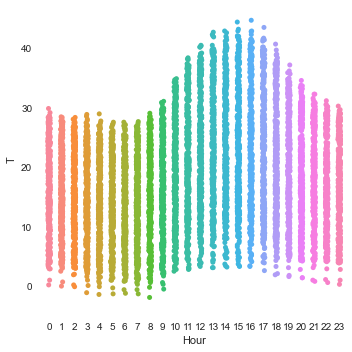

In [26]:
sns.catplot(y='T', x= 'Hour',data=data)

**Observation**:The tempearature is high between 10-16 hour time.So the RH is low between that time for all the months 

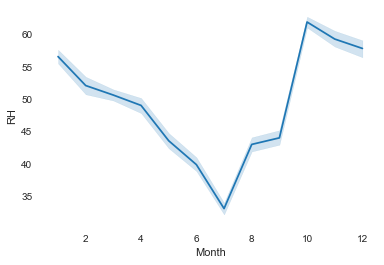

In [27]:
sns.lineplot(x='Month', y='RH', data=data)

**Observation**: With the passing month,the Relative humidity decreases till July then again it increases till October and it dips down.
So the highest Relative humidity is in the month of October

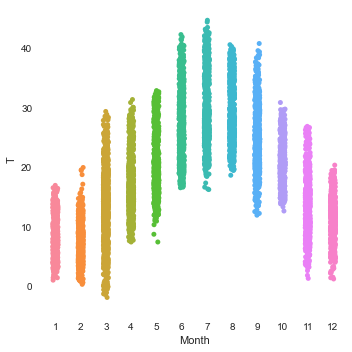

In [28]:
sns.catplot(y='T', x= 'Month',data=data)


**Observation**:So the temperature increses from the month between 6-9 .So these are the months where RH is low

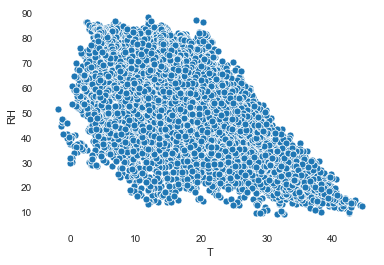

In [29]:
sns.scatterplot(x='T',y='RH',data=data)

**Observation**:With increase in temperature the relative humidity decreases. so there is some relationship between RH and Temperature

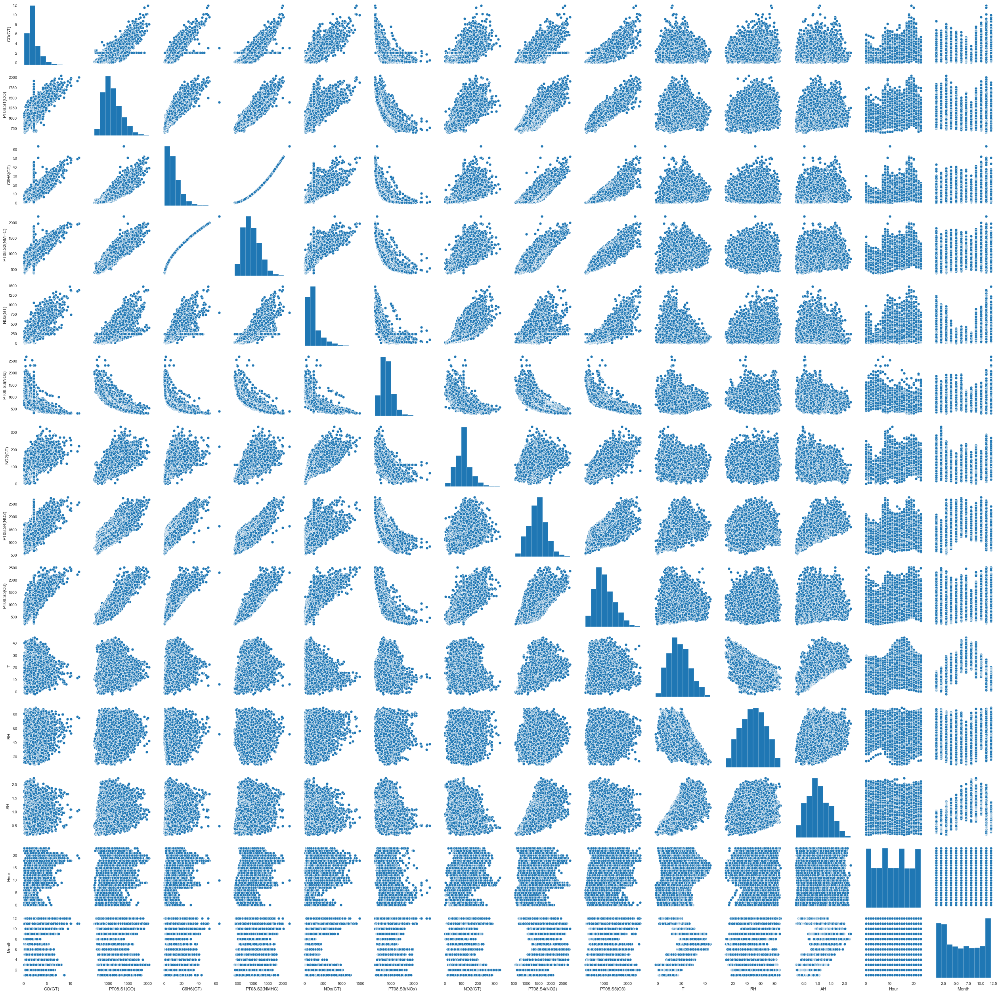

In [30]:
sns.pairplot(data)

**Observation**: Majority of the columns does not follow the normal distributions . So we will go for MinMaxScaler transformation

## Correlation Matrix

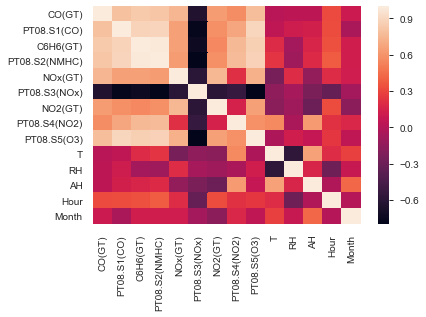

In [31]:
correc= data.corr
sns.heatmap(correc())

Finding correlation between variables

In [32]:
correc = data.corr
correc()

,CO(GT),PT08.S1(CO),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH,Hour,Month
CO(GT),1.000000,0.800535,0.840490,0.823196,0.752791,-0.635334,0.636010,0.576821,0.785709,0.020051,0.044529,0.043457,0.324816,0.097419
PT08.S1(CO),0.800535,1.000000,0.883795,0.892964,0.650713,-0.771938,0.584936,0.682881,0.899324,0.048627,0.114606,0.135324,0.328035,-0.040345
C6H6(GT),0.840490,0.883795,1.000000,0.981950,0.651234,-0.735744,0.556664,0.765731,0.865689,0.198956,-0.061681,0.167972,0.344169,0.128537
PT08.S2(NMHC),0.823196,0.892964,0.981950,1.000000,0.635497,-0.796703,0.582967,0.777254,0.880578,0.241373,-0.090380,0.186933,0.389196,0.128246
NOx(GT),0.752791,0.650713,0.651234,0.635497,1.000000,-0.594881,0.758046,0.216447,0.726933,-0.249307,0.202537,-0.135362,0.202333,0.122629
PT08.S3(NOx),-0.635334,-0.771938,-0.735744,-0.796703,-0.594881,1.000000,-0.591566,-0.538468,-0.796569,-0.145112,-0.056740,-0.232017,-0.323674,-0.061561
NO2(GT),0.636010,0.584936,0.556664,0.582967,0.758046,-0.591566,1.000000,0.145700,0.654040,-0.172381,-0.084063,-0.303675,0.331895,-0.160853
PT08.S4(NO2),0.576821,0.682881,0.765731,0.777254,0.216447,-0.538468,0.145700,1.000000,0.591144,0.561270,-0.032188,0.629641,0.221251,0.176311
PT08.S5(O3),0.785709,0.899324,0.865689,0.880578,0.726933,-0.796569,0.654040,0.591144,1.000000,-0.027172,0.124956,0.070751,0.245063,0.049029
T,0.020051,0.048627,0.198956,0.241373,-0.249307,-0.145112,-0.172381,0.561270,-0.027172,1.000000,-0.578621,0.656397,0.206642,0.282929


In [33]:
cat = ['Hour','Month']

In [34]:
col = data.columns

In [35]:
thres = 0.8

for c in col:
    for r in col:
        if(r<c):
            if (c is not 'RH') and (c not in cat) and (r is not 'RH') and (r not in cat):
                if abs(correc()[c][r])>thres:
                    print(c,r,str(correc()[c][r]))
                

CO(GT) C6H6(GT) 0.8404901529596167
PT08.S1(CO) CO(GT) 0.8005345034035
PT08.S1(CO) C6H6(GT) 0.8837950766080604
PT08.S2(NMHC) CO(GT) 0.82319560765703
PT08.S2(NMHC) PT08.S1(CO) 0.8929643887070445
PT08.S2(NMHC) C6H6(GT) 0.981950315801252
PT08.S5(O3) PT08.S1(CO) 0.8993235214436079
PT08.S5(O3) C6H6(GT) 0.8656885045054649
PT08.S5(O3) PT08.S2(NMHC) 0.8805777489667826


**Observation**:These are the variables which are highly correlated with each other. in order to avoid multicollinearity we will drop the columns with high correlation value.

In [25]:
high_correc =['PT08.S2(NMHC)','PT08.S1(CO)','PT08.S5(O3)']

In [26]:
data.drop(high_correc,axis = 1,inplace = True)

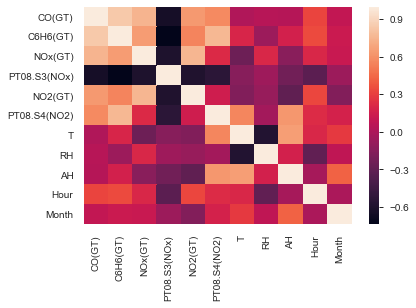

In [38]:
correc= data.corr()
sns.heatmap(correc)

In [39]:
correc = data.corr
col = data.columns

In [40]:
date = ['Month','Hour']

In [41]:
thres = 0.8

for c in col:
    for r in col:
        if(r<c):
            if (c is not 'RH') and (c not in date) and (r is not 'RH') and (r not in date):
                if abs(correc()[c][r])>thres:
                    print(c,r,str(correc()[c][r]))

CO(GT) C6H6(GT) 0.8404901529596167


In [42]:
data.head()

,CO(GT),C6H6(GT),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),T,RH,AH,Hour,Month
0,2.6,11.9,166.0,1056.0,113.0,1692.0,13.6,48.9,0.7578,18,3
1,2.0,9.4,103.0,1174.0,92.0,1559.0,13.3,47.7,0.7255,19,3
2,2.2,9.0,131.0,1140.0,114.0,1555.0,11.9,54.0,0.7502,20,3
3,2.2,9.2,172.0,1092.0,122.0,1584.0,11.0,60.0,0.7867,21,3
4,1.6,6.5,131.0,1205.0,116.0,1490.0,11.2,59.6,0.7888,22,3


### Creating Dummy Variables

In [27]:
dummy = pd.get_dummies(data['Month'],drop_first=True,prefix='month')
dummy1 = pd.get_dummies(data['Hour'],drop_first=True,prefix='hour')
data.drop(['Month','Hour'],axis = 1,inplace = True)

**Observation**:Since 'Month' and 'Hour' are categorical label so creating dummy variables and dropping the 'Month' and 'Hour' variables

In [28]:
data1 = data.drop(['RH'],axis =1)

## Standardized the data

In [29]:
from sklearn.preprocessing import MinMaxScaler
scaled = MinMaxScaler()

In [30]:
scaled.fit(data1)

MinMaxScaler(copy=True, feature_range=(0, 1))

In [31]:
input_scaled=scaled.transform(data1)

In [32]:
input_scaled = pd.DataFrame(input_scaled,columns=data1.columns)

Creating scaled input variables

In [33]:
print(input_scaled.shape)
print(dummy.shape)
print(dummy1.shape)

(8991, 8)
(8991, 11)
(8991, 23)


In [34]:
data = data['RH']

In [152]:
data.shape

(8991,)

Concatenating scaled input,dummy and the output variables.We haven't scaled the output variable for better understnding the rmse and null rmse value

In [35]:
newdata = pd.concat([input_scaled,dummy,dummy1,data],axis = 1)

**Subsampling the data**

In [36]:
n = newdata.shape[0]
newdata = newdata.sample(n)

In [155]:
newdata.tail()

,CO(GT),C6H6(GT),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),T,AH,month_2,month_3,...,hour_15,hour_16,hour_17,hour_18,hour_19,hour_20,hour_21,hour_22,hour_23,RH
4645,0.067797,0.045597,0.068382,0.381194,0.135952,0.248651,0.505376,0.326052,0,0,...,0,0,0,0,0,0,0,0,0,33.4
5934,0.084746,0.031447,0.033175,0.290978,0.117825,0.270234,0.356989,0.432830,0,0,...,0,0,0,0,0,0,0,0,0,64.4
2665,0.050847,0.070755,0.032498,0.273613,0.226586,0.409173,0.544086,0.475199,0,0,...,0,0,0,0,0,0,0,0,0,40.6
1182,0.076271,0.077044,0.162620,0.271495,0.332765,0.470773,0.378495,0.578410,0,0,...,0,0,0,0,0,0,0,0,0,77.4
1503,0.152542,0.135220,0.092079,0.221940,0.287009,0.475270,0.410753,0.409959,0,0,...,0,0,0,0,0,0,0,0,0,52.8


## Model Building

### Prepare the data

In [37]:
# Importing Models
from sklearn import svm, tree, linear_model, neighbors, naive_bayes, ensemble, discriminant_analysis, gaussian_process
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import AdaBoostRegressor, RandomForestRegressor, GradientBoostingRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.svm import SVR, LinearSVR
from xgboost import XGBRegressor
from lightgbm import LGBMRegressor

# Importing other tools
from sklearn import model_selection
from sklearn.metrics import mean_absolute_error,mean_squared_error
from sklearn.model_selection import StratifiedKFold, cross_validate
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.calibration import CalibratedClassifierCV

In [38]:
# Defining random seed
seed=32

# Creating Models
svc = SVR()
dtree = DecisionTreeRegressor(random_state=seed)
rf = RandomForestRegressor(10, random_state=seed)
gdb = GradientBoostingRegressor(random_state=seed)
adb = AdaBoostRegressor(random_state=seed)
xgb = XGBRegressor(random_state=seed)
knn = KNeighborsRegressor()
lgbm = LGBMRegressor(random_state=seed)
lr = LinearRegression()

first_models = [svc, dtree, 
                 rf, gdb, adb, xgb, knn, lgbm,lr]
first_model_names = ['SVM','Decision Tree', 
                     'Random Forest', 'GradientBoosting',
                    'AdaBoost', 'XGB', 'K-Neighbors','Light GBM','LinearRegression'] 

# Defining other steps
n_folds = 3
skf = model_selection.ShuffleSplit(n_splits = n_folds, test_size = .3, train_size = .7, random_state = seed ) 
std_sca = MinMaxScaler()

### Input and Output variable

In [39]:
x=newdata.drop(['RH'],axis = 1)
y = newdata['RH']

### Initial Model building

In [40]:
MLA_columns = ['MLA Name', 'MLA Parameters','MLA Train Accuracy Mean', 'MLA Test Accuracy Mean','MLA Time']
MLA_compare = pd.DataFrame(columns = MLA_columns)


train_size = x.shape[0]
n_models = len(first_models)
oof_pred = np.zeros((train_size, n_models))
scores = []
row_index=0

for n, model in enumerate(first_models):
    model_pipeline = Pipeline(steps=[('Scaler', std_sca),
                                     ('Estimator', model)])
    MLA_name = model.__class__.__name__
    MLA_compare.loc[row_index, 'MLA Name'] = MLA_name
    MLA_compare.loc[row_index, 'MLA Parameters'] = str(model.get_params())
    
    cv_results = model_selection.cross_validate(model, x, y, cv  = skf, return_train_score=True)

    MLA_compare.loc[row_index, 'MLA Time'] = cv_results['fit_time'].mean()
    MLA_compare.loc[row_index, 'MLA Train Accuracy Mean'] = cv_results['train_score'].mean()
    MLA_compare.loc[row_index, 'MLA Test Accuracy Mean'] = cv_results['test_score'].mean()  
   
    model_pipeline.fit(x,y)
    row_index+=1
        

[15:11:25] WARNING: src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[15:11:26] WARNING: src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[15:11:27] WARNING: src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[15:11:28] WARNING: src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


### Algorithms with their scoring values

In [41]:
MLA_compare.sort_values(by='MLA Test Accuracy Mean',ascending=False)

,MLA Name,MLA Parameters,MLA Train Accuracy Mean,MLA Test Accuracy Mean,MLA Time
7,LGBMRegressor,"{'boosting_type': 'gbdt', 'class_weight': None...",0.998713,0.997935,0.324982
2,RandomForestRegressor,"{'bootstrap': True, 'criterion': 'mse', 'max_d...",0.999486,0.997932,0.471042
1,DecisionTreeRegressor,"{'criterion': 'mse', 'max_depth': None, 'max_f...",1,0.994443,0.0989718
5,XGBRegressor,"{'base_score': 0.5, 'booster': 'gbtree', 'cols...",0.991261,0.989685,0.891094
3,GradientBoostingRegressor,"{'alpha': 0.9, 'criterion': 'friedman_mse', 'i...",0.991261,0.989576,0.933759
8,LinearRegression,"{'copy_X': True, 'fit_intercept': True, 'n_job...",0.897243,0.897251,0.0942756
4,AdaBoostRegressor,"{'base_estimator': None, 'learning_rate': 1.0,...",0.886505,0.883473,1.08899
6,KNeighborsRegressor,"{'algorithm': 'auto', 'leaf_size': 30, 'metric...",0.81659,0.704713,0.0518574
0,SVR,"{'C': 1.0, 'cache_size': 200, 'coef0': 0.0, 'd...",0.550787,0.556759,4.21119


**Observation**: RandomForest,LGBM and DecisionTree with the highest test accuracy

### Understand feature importance

In [42]:
feature_names = x.columns
feat_imp_df = pd.DataFrame(columns=first_model_names, index=feature_names)

# Dropping the Models that don't have feature importances for this analysis
feat_imp_df.drop(['SVM','K-Neighbors','LinearRegression'], axis=1, inplace=True)

feat_imp_df['Decision Tree'] = dtree.feature_importances_
feat_imp_df['Random Forest'] = rf.feature_importances_
feat_imp_df['GradientBoosting'] = gdb.feature_importances_
feat_imp_df['AdaBoost'] = adb.feature_importances_
feat_imp_df['XGB'] = xgb.feature_importances_
feat_imp_df['Light GBM'] = lgbm.feature_importances_
feat_imp_df.head()

,Decision Tree,Random Forest,GradientBoosting,AdaBoost,XGB,Light GBM
CO(GT),0.000084,0.000152,0.000012,0.000000,0.000917,37
C6H6(GT),0.000117,0.000180,0.000013,0.000077,0.003586,50
NOx(GT),0.000091,0.000160,0.000000,0.010204,0.000009,53
PT08.S3(NOx),0.000131,0.000208,0.000006,0.000000,0.003004,66
NO2(GT),0.000111,0.000185,0.000008,0.004927,0.000000,42


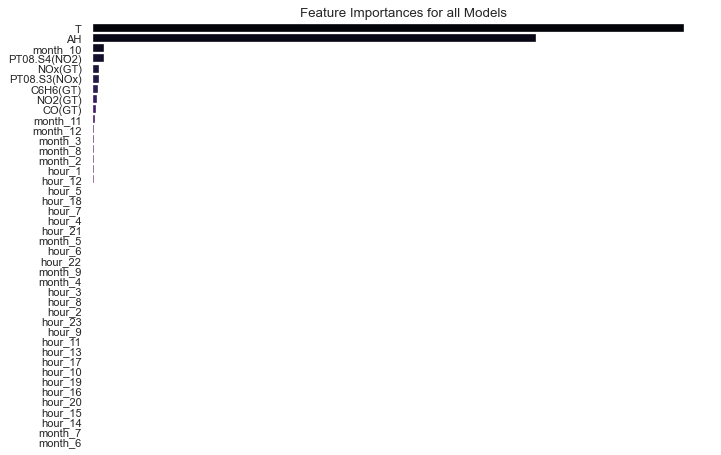

In [43]:
from sklearn.preprocessing import MinMaxScaler
mms = MinMaxScaler()

scaled_fi = pd.DataFrame(data=mms.fit_transform(feat_imp_df),
                         columns=feat_imp_df.columns,
                         index=feat_imp_df.index)
scaled_fi['Overall'] = scaled_fi.sum(axis=1)

ordered_ranking = scaled_fi.sort_values('Overall', ascending=False)
fig, ax = plt.subplots(figsize=(10,7), dpi=80)
sns.barplot(data=ordered_ranking, y=ordered_ranking.index, x='Overall', palette='magma')
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.xaxis.set_visible(False)
ax.grid(False)
ax.set_title('Feature Importances for all Models');

In [62]:
ordered_ranking.index

Index(['T', 'AH', 'month_10', 'PT08.S4(NO2)', 'PT08.S3(NOx)', 'NOx(GT)',
       'C6H6(GT)', 'NO2(GT)', 'CO(GT)', 'month_11', 'month_12', 'month_3',
       'month_2', 'month_8', 'hour_1', 'hour_12', 'hour_5', 'hour_18',
       'hour_7', 'hour_4', 'hour_21', 'month_5', 'hour_6', 'month_9',
       'hour_22', 'month_4', 'hour_3', 'hour_13', 'hour_8', 'hour_2',
       'hour_23', 'hour_9', 'hour_17', 'hour_11', 'hour_10', 'hour_19',
       'hour_16', 'hour_15', 'hour_20', 'hour_14', 'month_7', 'month_6'],
      dtype='object')

**Keeping only the relevant features**

In [44]:
imp_features = newdata[['T', 'AH', 'month_10', 'PT08.S4(NO2)', 'PT08.S3(NOx)', 'NOx(GT)',
       'C6H6(GT)', 'NO2(GT)', 'CO(GT)', 'month_11', 'month_12', 'month_3',
       'month_2', 'month_8', 'hour_1', 'hour_12']]

In [45]:
imp_features.head()

,T,AH,month_10,PT08.S4(NO2),PT08.S3(NOx),NOx(GT),C6H6(GT),NO2(GT),CO(GT),month_11,month_12,month_3,month_2,month_8,hour_1,hour_12
5328,0.475269,0.659874,1,0.404227,0.188903,0.078538,0.110063,0.181269,0.093220,0,0,0,0,0,0,0
1392,0.344086,0.350926,0,0.473022,0.217281,0.162620,0.154088,0.332765,0.172009,0,0,0,0,0,0,0
8607,0.496774,0.346772,0,0.277878,0.165184,0.116452,0.083333,0.353474,0.110169,0,0,1,0,0,0,0
5035,0.408602,0.423007,1,0.408723,0.172808,0.162620,0.169811,0.332765,0.172009,0,0,0,0,0,0,0
1614,0.496774,0.309388,0,0.306655,0.462092,0.162620,0.017296,0.332765,0.008475,0,0,0,0,0,0,0


### Input and Output Variable

In [46]:
x = imp_features
y = newdata['RH']

### Model Building after removing irrelevant features

In [47]:
MLA_columns = ['MLA Name', 'MLA Parameters','MLA Train Accuracy Mean', 'MLA Test Accuracy Mean','MLA Time']
MLA_compare = pd.DataFrame(columns = MLA_columns)



train_size = x.shape[0]
n_models = len(first_models)
oof_pred = np.zeros((train_size, n_models))
scores = []
row_index=0

for n, model in enumerate(first_models):
    model_pipeline = Pipeline(steps=[('Scaler', std_sca),
                                     ('Estimator', model)])
    MLA_name = model.__class__.__name__
    MLA_compare.loc[row_index, 'MLA Name'] = MLA_name
    MLA_compare.loc[row_index, 'MLA Parameters'] = str(model.get_params())
    
    cv_results = model_selection.cross_validate(model, x, y, cv  = skf, return_train_score=True)

    MLA_compare.loc[row_index, 'MLA Time'] = cv_results['fit_time'].mean()
    MLA_compare.loc[row_index, 'MLA Train Accuracy Mean'] = cv_results['train_score'].mean()
    MLA_compare.loc[row_index, 'MLA Test Accuracy Mean'] = cv_results['test_score'].mean()
    
    model_pipeline.fit(x,y)
    row_index+=1
        

[15:12:52] WARNING: src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[15:12:52] WARNING: src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[15:12:53] WARNING: src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[15:12:53] WARNING: src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


In [48]:
MLA_compare.sort_values(by='MLA Test Accuracy Mean',ascending=False)

,MLA Name,MLA Parameters,MLA Train Accuracy Mean,MLA Test Accuracy Mean,MLA Time
2,RandomForestRegressor,"{'bootstrap': True, 'criterion': 'mse', 'max_d...",0.999513,0.998074,0.449056
7,LGBMRegressor,"{'boosting_type': 'gbdt', 'class_weight': None...",0.998713,0.997954,0.305811
1,DecisionTreeRegressor,"{'criterion': 'mse', 'max_depth': None, 'max_f...",1,0.994543,0.0589635
5,XGBRegressor,"{'base_score': 0.5, 'booster': 'gbtree', 'cols...",0.991208,0.989622,0.451321
3,GradientBoostingRegressor,"{'alpha': 0.9, 'criterion': 'friedman_mse', 'i...",0.991261,0.989578,0.625554
6,KNeighborsRegressor,"{'algorithm': 'auto', 'leaf_size': 30, 'metric...",0.948371,0.919985,0.0466374
8,LinearRegression,"{'copy_X': True, 'fit_intercept': True, 'n_job...",0.887546,0.888007,0.00999371
4,AdaBoostRegressor,"{'base_estimator': None, 'learning_rate': 1.0,...",0.886505,0.883473,0.647935
0,SVR,"{'C': 1.0, 'cache_size': 200, 'coef0': 0.0, 'd...",0.65632,0.666394,2.61939


**There is an increase in test accuracy for KNN,SVR,AdaBoost after removing irrelevant features**

## Stacking through mlxtend

In [49]:
from mlxtend.regressor import StackingRegressor

In [50]:
lgbm_cl = LGBMRegressor(random_state=seed)



In [51]:
rf_cl = RandomForestRegressor(10, random_state=seed)

In [52]:
gdb_cl = GradientBoostingRegressor(random_state=seed)

In [53]:
lr = LinearRegression()

In [54]:
sclf = StackingRegressor(regressors=[lgbm_cl, rf_cl,gdb_cl],
                          meta_regressor=lr)

label = ['LGBM', 'Random Forest','GDB' 'Stacking Regressor']
clf_list = [lgbm_cl, rf_cl,gdb_cl, lr]

In [55]:
for clf, label in zip([lgbm_cl, rf_cl,gdb_cl,sclf], 
                      ['LGBM', 
                       'Random Forest', 
                       'GDB',
                       'StackingRegressor']):

    scores = model_selection.cross_val_score(clf, x, y, cv=3)
    print("Accuracy: %0.2f (+/- %0.2f) [%s]" 
          % (scores.mean(), scores.std(), label))

Accuracy: 1.00 (+/- 0.00) [LGBM]
Accuracy: 1.00 (+/- 0.00) [Random Forest]
Accuracy: 0.99 (+/- 0.00) [GDB]
Accuracy: 1.00 (+/- 0.00) [StackingRegressor]


**ALL the models have perfect accuracy except GDB**

## Evaluating the Models with RMSE value

In [56]:
data = pd.concat([x,y],axis = 1)
n=data.shape[0]
data = data.sample(n)

**Subsampling the data**

In [57]:
data = data.sample(n)
data.shape

(8991, 17)

In [58]:
x = data.drop(['RH'],axis = 1)
y = data['RH']

## Train-test split

In [59]:
x_train,x_test,y_train,y_test = train_test_split(x,y,test_size = 0.2,random_state = 32)

**Null RMSE**

In [60]:
y_null= np.zeros_like(y_test)
y_null.fill(y_test.mean())

In [196]:
y_null

array([48.84346859, 48.84346859, 48.84346859, ..., 48.84346859,
       48.84346859, 48.84346859])

In [61]:
first_models = [svc, dtree, 
                 rf, gdb, adb, xgb, knn, lgbm,lr,sclf]
first_model_names = ['SVM','Decision Tree', 
                     'Random Forest', 'GradientBoosting',
                    'AdaBoost', 'XGB', 'K-Neighbors','Light GBM','LinearRegression','Stacking'] 


In [62]:
metrics = pd.DataFrame()

In [63]:
def model_fit(model,name):
    row_index=0
    for (i,j) in zip(model,name):
        #print("Name:",name)
        metrics.loc[row_index,'Name'] = j
        i.fit(x_train,y_train)
        score = i.score(x_train,y_train)
        #print("Train Score:",score)
        metrics.loc[row_index,'Train Score'] = score
        test_score=i.score(x_test,y_test)
        #print("Test Score:",test_score)
        metrics.loc[row_index,'Test Score'] = test_score
        y_predict = i.predict(x_test)
        null_mae=mean_absolute_error(y_test,y_null)
        #print("Null_MAE:",null_mae)
        metrics.loc[row_index,"Null_MAE"] = null_mae
        mae=mean_absolute_error(y_test,y_predict)
        #print("TEST_MAE:",mae)
        metrics.loc[row_index,"MAE"] = mae
        null_rmse=np.sqrt(mean_squared_error(y_test,y_null))
        #print("Null_rmse:",null_rmse)
        metrics.loc[row_index,"Null_RMSE"] = null_rmse
        rmse=np.sqrt(mean_squared_error(y_test,y_predict))
        #print("Test_Rmse:",rmse)
        metrics.loc[row_index,"Rmse"] = rmse
        row_index = row_index+1
            

In [64]:
model_fit(first_models,first_model_names)

[15:14:14] WARNING: src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


**Random forest and Stacking has the least RMSE value**

In [65]:
metrics.sort_values(by='Rmse',ascending = True)

,Name,Train Score,Test Score,Null_MAE,MAE,Null_RMSE,Rmse
9,Stacking,0.999638,0.998699,14.341231,0.425045,17.266605,0.622873
2,Random Forest,0.999575,0.998362,14.341231,0.479872,17.266605,0.698747
7,Light GBM,0.998737,0.998130,14.341231,0.556484,17.266605,0.746677
1,Decision Tree,1.000000,0.995081,14.341231,0.861312,17.266605,1.211018
3,GradientBoosting,0.991400,0.990052,14.341231,1.297521,17.266605,1.722171
5,XGB,0.991403,0.990008,14.341231,1.292486,17.266605,1.725961
6,K-Neighbors,0.953470,0.919813,14.341231,3.345536,17.266605,4.889424
8,LinearRegression,0.887592,0.888406,14.341231,4.422725,17.266605,5.768021
4,AdaBoost,0.871647,0.870130,14.341231,4.990450,17.266605,6.222444
0,SVM,0.700623,0.700649,14.341231,7.385350,17.266605,9.447067


In [66]:
y_predict = rf.predict(x_test)

## Model Explainability

### LIME

In [67]:
import lime
import lime.lime_tabular

In [68]:
# Import lime package
#import lime
#import lime.lime_tabular

categorical_features = np.argwhere(np.array([len(set(x_test.values[:,x])) for x in range(x_test.values.shape[1])]) <= 10).flatten()
#Lime explainer for regression
explainer = lime.lime_tabular.LimeTabularExplainer(x_test.values,
feature_names=x_test.columns.values.tolist(),
class_names=['RH'],
categorical_features=categorical_features,verbose=True, mode='regression')
ind = 10
#Fit on test data
exp = explainer.explain_instance(x_test.values[ind], rf.predict, num_features=6)
#Show in notebook features influencing predictions
exp.show_in_notebook(show_table=True)

Intercept 59.83579944426886
Prediction_local [22.08041465]
Right: 23.320000000000004


**Observation**:For the input variable at index 10 the lime prediction is 22.08 while the correct prediction is 23.32.
Lime locally explains the model. So with the increase in  PT08.S4(NO2),C6H6(GT),PT08.S3(NOx) value  the relative humidity increases and with T,AH, value decreases the relative humidity decreases . So  PT08.S4(NO2),C6H6(GT),PT08.S3(NOx) these features has positive impact while T,AH,month_3 have negative impact on Relative humidity.

## ELI5

In [72]:

import eli5

# Import Eli5 package
from eli5.sklearn import PermutationImportance

# Find the importance of columns for prediction
random_model = PermutationImportance(rf, random_state=32).fit(x_test,y_predict)
eli5.show_weights(random_model, feature_names = x_test.columns.tolist())



Weight,Feature
2.6124 ± 0.0914,T
1.7838 ± 0.0618,AH
0.0001 ± 0.0000,PT08.S4(NO2)
0.0001 ± 0.0000,C6H6(GT)
0.0001 ± 0.0000,PT08.S3(NOx)
0.0001 ± 0.0000,NO2(GT)
0.0001 ± 0.0000,NOx(GT)
0.0001 ± 0.0000,CO(GT)
0.0000 ± 0.0000,month_3
0.0000 ± 0.0000,month_2


**Observation**: For the overall model the Temperature,AH,PTO8.S4(NO2) have massive impact on the model.


## SHAP

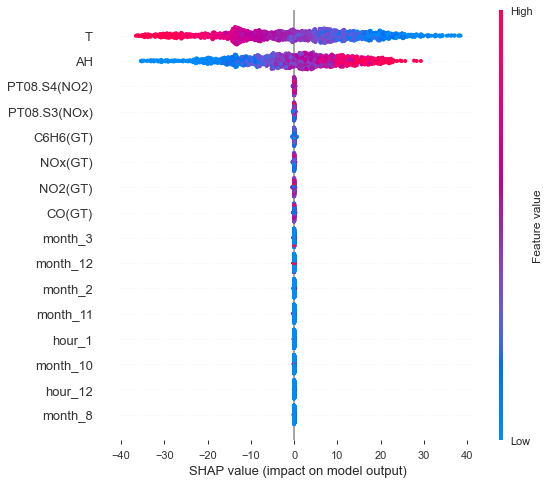

In [73]:
import shap
shap_values = shap.TreeExplainer(rf).shap_values(x_test)
shap.summary_plot(shap_values, x_test)

**Obeservation**: The Temperature has negative impact on Relative humidity.While shap value for AH is more on negative side than on positive side

In [75]:
explainer = shap.TreeExplainer(rf)

In [76]:
#Understanding how each feature influences the prediction

shap.initjs()
shap.force_plot(
    explainer.expected_value, shap_values[ind,:], x_test.iloc[ind,:],
    feature_names=x_test.columns.tolist()
)